<a href="https://colab.research.google.com/github/faizan-code/Shape.AI/blob/main/Shape_AI_Colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## NAME - Faizan Ashraf
## Gmail - go2faizanashraf@gmail.com

## Candidate type - B
## Applied through - Internshala

<h1><b><u><center><font color="Blue">SHAPE.AI INTERNSHIP TASK </FONT><br>
    
    




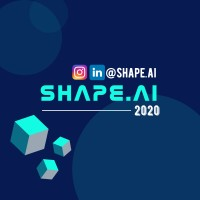

In [1]:
# to insert image in Glab

from IPython.display import Image
Image('/content/shape.jpg',width = 600, height = 350)

<br>



## Importing Modules

In [2]:
pip install --upgrade plotly

     |████████████████████████████████| 13.2MB 231kB/s 
  Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [3]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.ticker as ticker
from matplotlib.pyplot import *
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelEncoder

%matplotlib inline

In [4]:
df = pd.read_csv('/content/train.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



In [5]:
df.head()

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,NaN,NaN,Afghanistan,27657145,0.058359,23-01-2020,ConfirmedCases,0
1,2,NaN,NaN,Afghanistan,27657145,0.583587,23-01-2020,Fatalities,0
2,3,NaN,NaN,Afghanistan,27657145,0.058359,24-01-2020,ConfirmedCases,0
3,4,NaN,NaN,Afghanistan,27657145,0.583587,24-01-2020,Fatalities,0
4,5,NaN,NaN,Afghanistan,27657145,0.058359,25-01-2020,ConfirmedCases,0


<br>

# Seeing Data Information

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 969640 entries, 0 to 969639
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Id              969640 non-null  int64  
 1   County          880040 non-null  object 
 2   Province_State  917280 non-null  object 
 3   Country_Region  969640 non-null  object 
 4   Population      969640 non-null  int64  
 5   Weight          969640 non-null  float64
 6   Date            969640 non-null  object 
 7   Target          969640 non-null  object 
 8   TargetValue     969640 non-null  int64  
dtypes: float64(1), int64(3), object(5)
memory usage: 66.6+ MB


<br>


## Lets See How many missing Values are their in each Columns 

<br>

In [7]:
missing = df.isnull().sum()
missing_pourcent = df.isnull().sum()/df.shape[0]*100

dic = {
    'mising':missing,
    'missing_pourcent %':missing_pourcent
}
frame=pd.DataFrame(dic)
frame

,mising,missing_pourcent %
Id,0,0.000000
County,89600,9.240543
Province_State,52360,5.399942
Country_Region,0,0.000000
Population,0,0.000000
Weight,0,0.000000
Date,0,0.000000
Target,0,0.000000
TargetValue,0,0.000000


In [8]:
df.shape

(969640, 9)

In [9]:
df.dtypes

Id                  int64
County             object
Province_State     object
Country_Region     object
Population          int64
Weight            float64
Date               object
Target             object
TargetValue         int64
dtype: object

<br>


### Lets see the above results with visuals

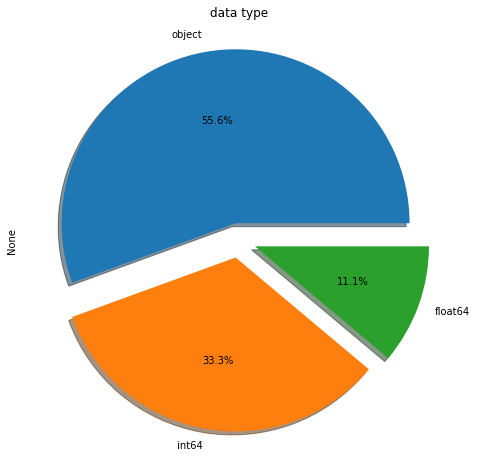

In [10]:
df.dtypes.value_counts().plot.pie(explode=[0.1,0.1,0.1],autopct='%1.1f%%',figsize=(12,8), shadow=True)
plt.title('data type');


<br>

### So we can say that our data had (969640 rows, 9 columns)
### more then 55% our data is object type
### 33% is integer
### 11% float


<br>

In [11]:
df['County'].value_counts()

Washington             8680
Jefferson              7280
Franklin               7000
Jackson                6720
Lincoln                6720
                       ... 
Zavala                  280
Southeast Fairbanks     280
Craven                  280
Hitchcock               280
Trousdale               280
Name: County, Length: 1840, dtype: int64


<br>

### Above we saw that County,Province_State column are having many missing value and according to me the best and most easy way to deal with this is to replace the missing value with the Country_region itself as even adding any randon county name and Province_State name will not make any change and in the later stage of code the data will be lable encoded.

<br>

In [12]:
df.County = df.County.fillna(df.Country_Region)
df.Province_State = df.Province_State.fillna(df.Country_Region)

In [13]:
df.head()

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,Afghanistan,Afghanistan,Afghanistan,27657145,0.058359,23-01-2020,ConfirmedCases,0
1,2,Afghanistan,Afghanistan,Afghanistan,27657145,0.583587,23-01-2020,Fatalities,0
2,3,Afghanistan,Afghanistan,Afghanistan,27657145,0.058359,24-01-2020,ConfirmedCases,0
3,4,Afghanistan,Afghanistan,Afghanistan,27657145,0.583587,24-01-2020,Fatalities,0
4,5,Afghanistan,Afghanistan,Afghanistan,27657145,0.058359,25-01-2020,ConfirmedCases,0


In [14]:
df.describe(include='all')

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
count,969640.000000,969640,969640,969640,9.696400e+05,969640.000000,969640,969640,969640.000000
unique,NaN,2024,319,187,NaN,NaN,140,2,NaN
top,NaN,US,Texas,US,NaN,NaN,16-05-2020,Fatalities,NaN
freq,NaN,15400,71400,895440,NaN,NaN,6926,484820,NaN
mean,484820.500000,NaN,NaN,NaN,2.720127e+06,0.530870,NaN,NaN,12.563518
std,279911.101847,NaN,NaN,NaN,3.477771e+07,0.451909,NaN,NaN,302.524795
min,1.000000,NaN,NaN,NaN,8.600000e+01,0.047491,NaN,NaN,-10034.000000
25%,242410.750000,NaN,NaN,NaN,1.213300e+04,0.096838,NaN,NaN,0.000000
50%,484820.500000,NaN,NaN,NaN,3.053100e+04,0.349413,NaN,NaN,0.000000
75%,727230.250000,NaN,NaN,NaN,1.056120e+05,0.968379,NaN,NaN,0.000000


<br>


### From the above distribution we can see that :
<h4>
Most of Country_Region case are in US with 895440<br><br>
Most of Province_State case are in Texas with 71400<br><br>
Most of County cases are in Washington with 8680<br><br>
The most case are at the date of 2020-05-20 with 6926<br><br>
The moste Target are Fatalities with 484820

<br>


## Drawing histagram plot for out Data

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f4e32c01a90>,
      dtype=object)

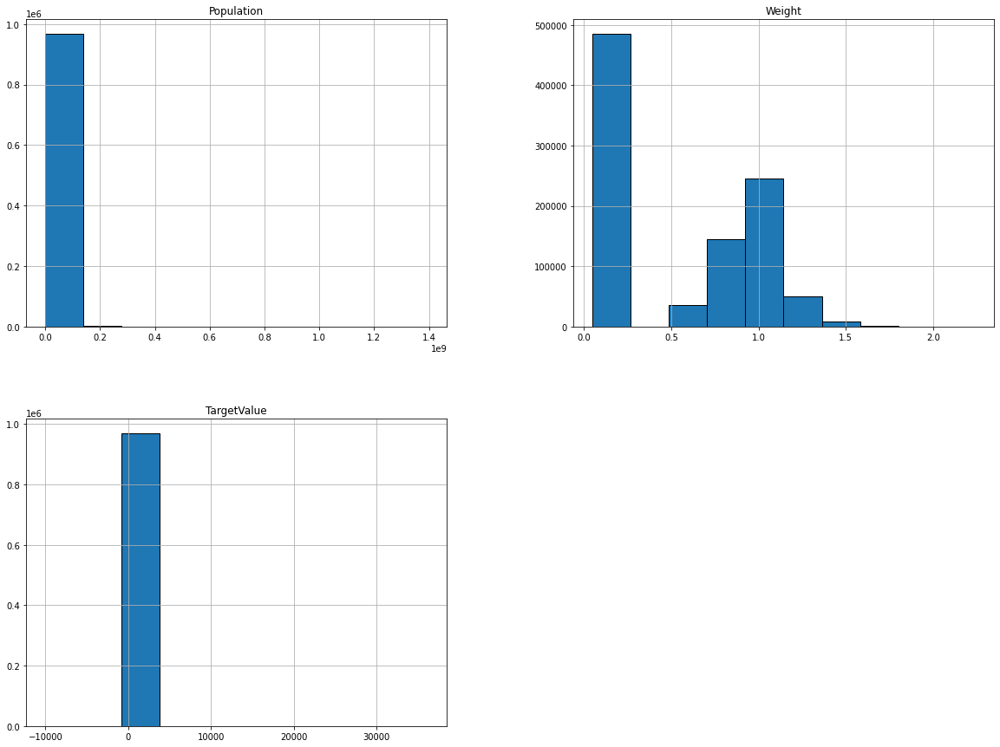

In [15]:
%matplotlib inline
df = df.drop(['Id'], axis = 1)
df.hist(figsize=(20,15),edgecolor='black')

In [16]:
df.corr()

,Population,Weight,TargetValue
Population,1.000000,-0.039878,0.161230
Weight,-0.039878,1.000000,-0.040699
TargetValue,0.161230,-0.040699,1.000000


In [17]:
df['TargetValue'].value_counts()

0       806895
1        47808
2        21279
3        12425
4         8620
         ...  
1272         1
3321         1
1784         1
3070         1
1023         1
Name: TargetValue, Length: 2603, dtype: int64

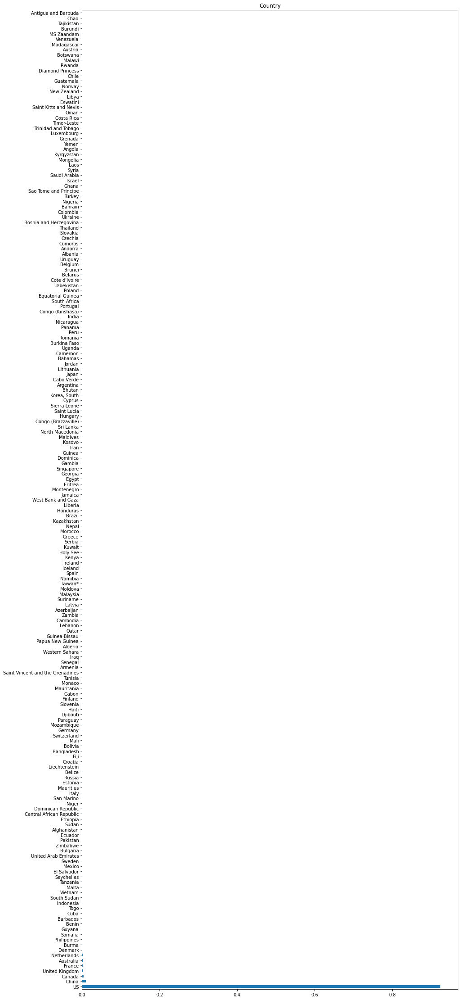

In [18]:
df["Country_Region"].value_counts(normalize=True).plot(kind='barh', figsize=(15, 40), title= 'Country');


## So from the above graph we can say that US, CHINA and FRACE are the Top three countries in the Data Set. with US at the Top - Around 840000 


<br>
<br>


<br>



Target              ConfirmedCases  Fatalities
Country_Region                                
Afghanistan                    140         140
Albania                        140         140
Algeria                        140         140
Andorra                        140         140
Angola                         140         140
...                            ...         ...
West Bank and Gaza             140         140
Western Sahara                 140         140
Yemen                          140         140
Zambia                         140         140
Zimbabwe                       140         140

[187 rows x 2 columns]


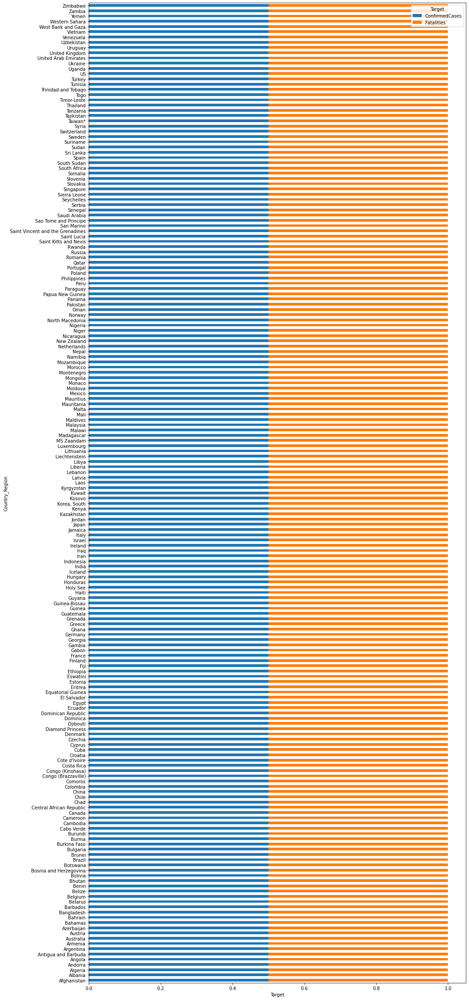

In [19]:
print(pd.crosstab(df['Country_Region'],df['Target']))

Country_Region = pd.crosstab(df['Country_Region'],df['Target'])
Country_Region.div(Country_Region.sum(1).astype(float), axis = 0).plot(kind='barh', figsize=(15, 40), stacked=True)
plt.xlabel('Target')
p = plt.ylabel('Country_Region')

## We see that each country we have are having same ConfirmedCases and Fatalities.



<br>
<br>

In [20]:
fig = px.pie(df, values='TargetValue', names='Target')
fig.update_traces(textposition='inside')
fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

In [21]:
fig = px.pie(df, values='TargetValue', names='Country_Region')
fig.update_traces(textposition='inside')


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



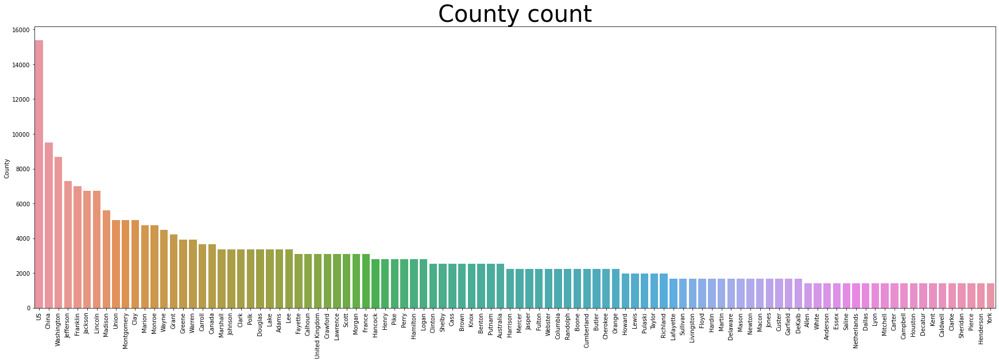

In [22]:
plt.figure(figsize=(30,9))
county_plot=df.County.value_counts().head(100)
sns.barplot(county_plot.index,county_plot)
plt.xticks(rotation=90)
plt.title('County count', fontsize=40);

In [23]:
confirmed=df[df['Target']=='ConfirmedCases']
fig = px.treemap(confirmed,  path=['Country_Region'], values='TargetValue',width=900, height=600)
fig.update_traces(textposition='middle center', textfont_size=15)
fig.update_layout(
    title={
        'text': 'Total Share of Worldwide Confirmed Cases',
        'y':0.92,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [24]:
dead=df[df['Target']=='Fatalities']
fig = px.treemap(dead, path=['Country_Region'], values='TargetValue',width=900,height=600)
fig.update_traces(textposition='middle center', textfont_size=15)
fig.update_layout(
    title={
        'text': 'Total Share of Worldwide Fatalities',
        'y':0.92,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [25]:
df.Target.value_counts()

Fatalities        484820
ConfirmedCases    484820
Name: Target, dtype: int64

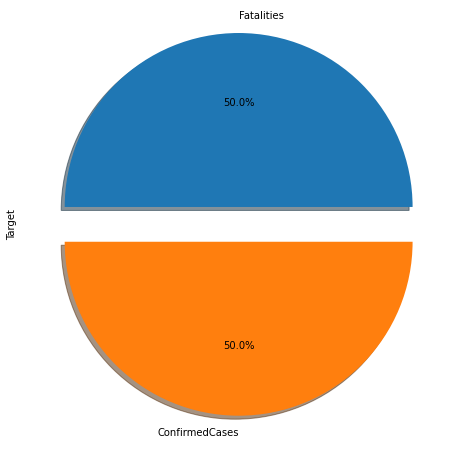

In [26]:
df.Target.value_counts().plot.pie(explode=[0.1,0.1],autopct='%1.1f%%', figsize=(8, 8),shadow=True)

### Here we saw that Confirmed Cases and Fatalities are same.


<br>
<br>

<br>



<br>


## Lets See the Top ten Country lastest Situation in the Cases

In [27]:
last_date = df.Date.max()
df_countries = df[df['Date']==last_date]
df_countries = df_countries.groupby('Country_Region', as_index=False)['TargetValue'].sum()
df_countries = df_countries.nlargest(10,'TargetValue')
df_trend = df.groupby(['Date','Country_Region'], as_index=False)['TargetValue'].sum()
df_trend = df_trend.merge(df_countries, on='Country_Region')
df_trend.rename(columns={'Country_Region':'Country', 'TargetValue_x':'Cases'}, inplace=True)

px.line(df_trend, x='Date', y='Cases', color='Country', title='Total Cases growth for top 10 worst affected countries')


### Here we can see that US and Brazil are the country where the growth of the cases are very fast.


<br>
<br>
<h1>---------------------------------------------------------------------------------------------------------------------------------------------</h1>


<br>

<br>



<h1><center><font color = "blue"> Now I am going to apply ML model in the Data Set </h1>
    
    
<h3><center><font color = "blue"> For that i will be using Random forest regression Algorithm as this is a Regression problem  and before starting the modeling part lets us first know what is Random Forest. </h1>

<font size= 4>Random forest is an ensemble of decision trees. This is to say that many trees, constructed in a certain “random” way form a Random Forest. 

Each tree is created from a different sample of rows and at each node, a different sample of features is selected for splitting. 
Each of the trees makes its own individual prediction. 
These predictions are then averaged to produce a single result. 

<font size= 3>Example: Suppose there is a dataset that contains multiple fruit images. So, this dataset is given to the Random forest classifier. The dataset is divided into subsets and given to each decision tree. During the training phase, each decision tree produces a prediction result, and when a new data point occurs, then based on the majority of results, the Random Forest classifier predicts the final decision. Consider the below image:

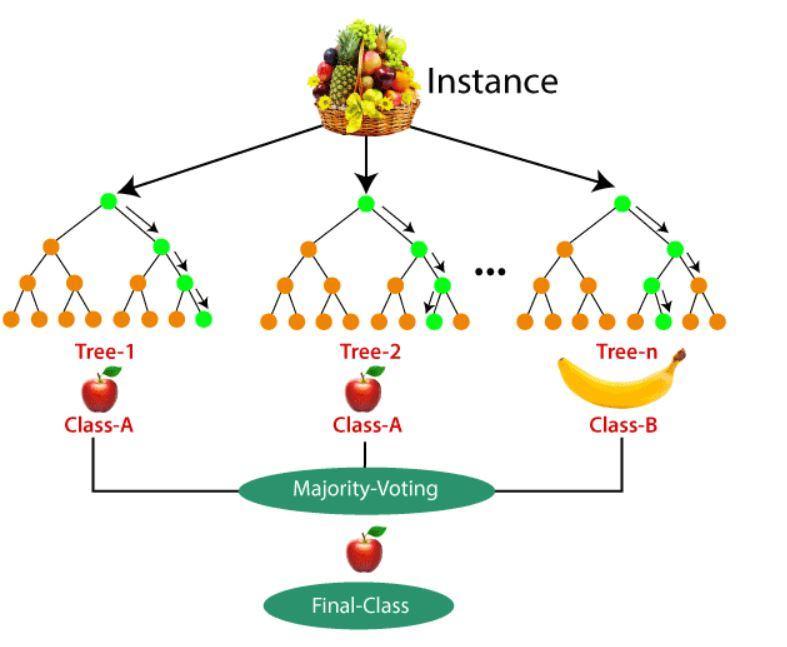

In [28]:
from IPython.display import Image
Image('/content/random_forest.JPG')

<br>



# Applying Random Forest in the given Data

In [29]:
df.isnull().sum()

County            0
Province_State    0
Country_Region    0
Population        0
Weight            0
Date              0
Target            0
TargetValue       0
dtype: int64

In [30]:
df.dtypes

County             object
Province_State     object
Country_Region     object
Population          int64
Weight            float64
Date               object
Target             object
TargetValue         int64
dtype: object

### Here we need to convert all dtype to int data type so that we can work with our data using Random Forest

In [31]:
df['Weight'] = df['Weight']*100


In [32]:
df['Weight'] = df['Weight'].astype(int)
df.head(3)

,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,Afghanistan,Afghanistan,Afghanistan,27657145,5,23-01-2020,ConfirmedCases,0
1,Afghanistan,Afghanistan,Afghanistan,27657145,58,23-01-2020,Fatalities,0
2,Afghanistan,Afghanistan,Afghanistan,27657145,5,24-01-2020,ConfirmedCases,0


In [33]:
df.dtypes

County            object
Province_State    object
Country_Region    object
Population         int64
Weight             int64
Date              object
Target            object
TargetValue        int64
dtype: object

In [34]:
from sklearn.model_selection import train_test_split

df, test = train_test_split(df, test_size=0.2)

<br>

## Here columns like County, province state have lot of Missing value So I fell better to remove these rows.



In [35]:
labelencoder = LabelEncoder()
# Assigning numerical values and storing in another column
df['Target'] = labelencoder.fit_transform(df['Target'])
test['Target'] = labelencoder.fit_transform(test['Target'])
df['Country_Region'] = labelencoder.fit_transform(df['Country_Region'])
test['Country_Region'] = labelencoder.fit_transform(test['Country_Region'])

In [36]:
df = df.drop(['County','Province_State'],axis=1)
test = test.drop(['County','Province_State'],axis=1)


In [37]:
def create_features(df):
    df['day'] = df['Date'].dt.day
    df['month'] = df['Date'].dt.month
    df['dayofweek'] = df['Date'].dt.dayofweek
    df['dayofyear'] = df['Date'].dt.dayofyear
    df['quarter'] = df['Date'].dt.quarter
    df['weekofyear'] = df['Date'].dt.weekofyear
    return df



def train_dev_split(df, days):
    #Last days data as dev set
    date = df['Date'].max() - dt.timedelta(days=days)
    return df[df['Date'] <= date], df[df['Date'] > date]


test_date_min = test['Date'].min()
test_date_max = test['Date'].max()


def avoid_data_leakage(df, date=test_date_min):
    return df[df['Date']<date]



def to_integer(dt_time):
    return 10000*dt_time.year + 100*dt_time.month + dt_time.day
df['Date']=pd.to_datetime(df['Date'])
test['Date']=pd.to_datetime(test['Date'])



test['Date']=test['Date'].dt.strftime("%Y%m%d")
df['Date']=df['Date'].dt.strftime("%Y%m%d").astype(int)

In [38]:
predictors = df.drop(['TargetValue'], axis=1)
target = df["TargetValue"]
X_train, X_test, y_train, y_test = train_test_split(predictors, target, test_size = 0.4, random_state = 42)

In [39]:
model = RandomForestRegressor(n_jobs=-1)
estimators = 350
model.set_params(n_estimators=estimators)

scores = []

pipeline = Pipeline([('scaler2' , StandardScaler()),
                        ('RandomForestRegressor: ', model)])
pipeline.fit(X_train , y_train)
prediction = pipeline.predict(X_test)

pipeline.fit(X_train, y_train)
scores.append(pipeline.score(X_test, y_test))


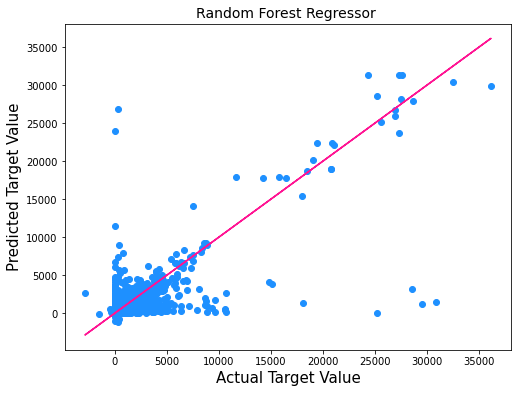

In [40]:
plt.figure(figsize=(8,6))
plt.plot(y_test,y_test,color='deeppink')
plt.scatter(y_test,prediction,color='dodgerblue')
plt.xlabel('Actual Target Value',fontsize=15)
plt.ylabel('Predicted Target Value',fontsize=15)
plt.title('Random Forest Regressor ',fontsize=14)
plt.show()

In [41]:
scores

[0.6458208182324889]

# Here we have do the ML modeling USING Random Forest Regressior getting Accuracy of around 65% to 70% with is quite good.

<h1><font color = "blue"> I really Enjoyed working in the Given Project. I hope my worked would be appreciated and I would be given chance to work in Shape.AI So that I could be more better in my skills.</h1></font>


<br>
<br>

<h1> Thanks for Giving me the opportunity</h1>

<h2> Nmae - Faizan Ashraf</h2>
<br>
<h2> Email - go2faizanashraf@gmail.com